# Quel est l'influence des conditions de bords sur la distributions des tailles d'avalanches? Quel est l'influence des conditions de bords sur la formations des patches dans le systeme?

Jusqu'à mention contraire on utilise le modèle OFC Classique:

#### Parametres:
256   # L     :lattice size\
0.0, 0.012, 0.04, 0.12, 0.4   # nu    : dissipation\
1e+07   #navmax     :maximum number of avalanches
##### Conditions initiales:
Site initialisés à une valeur aléatoire entre 0 et 1.
#### Threshold:
Fixe à 1


In [1]:
from pathlib import Path
import os
from mainfct import mainfct
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import gridspec

def avg(tabbin, nalpha, nbfile, nbins):
    nbdisip=int(nalpha/nbfile)
    xmoy=np.zeros((nbdisip,nbins))
    ymoy=np.zeros((nbdisip,nbins))

    x=0
    for i in range(nalpha):
        if (x== nbdisip):
            x=0
        for j in range(nbins):
            xmoy[x,j]+=tabbin[i, j, 0]/nbfile
            ymoy[x,j]+=tabbin[i, j, 1]/nbfile     
            
        x+=1
        
    return (xmoy, ymoy)


def stdev (tabbin, nalpha, nbfile, nbins, xtabmoy, ytabmoy):
    nbdisip=nalpha//nbfile
    xstddev=np.zeros((nbdisip,nbins))
    ystddev=np.zeros((nbdisip,nbins))
    
    x=0

    for i in range(nalpha):
        if (x== nbdisip):
            x=0
        for j in range(nbins):
            xstddev[x,j]+=(tabbin[i,j,0]-xtabmoy[x,j])**2
            ystddev[x,j]+=(tabbin[i,j,1]-ytabmoy[x,j])**2
        x+=1
        

    xstddev=(xstddev/nbfile)**(1/2)
    ystddev=(ystddev/nbfile)**(1/2)
    
    return (xstddev, ystddev)

def coorno(n):
    x1=n%L
    x2=n//L
    return (x1, x2)

## Conditions de bords ouvert

In [2]:
nbfile=1 #nb of different data
alpha=[14,22,24,247, 25]*nbfile #dissipation for each datafile
nalpha=len(alpha)
ncifras=[100,100,100,1000,100]*nbfile #to put in fraction
dim=[2]*nalpha  # Dimension of the sys for each datafile 
nbins=12  #nb of points for the fit
L=256
lenghtTab=20*L**2 
nbdisip=int(nalpha/nbfile)



path=Path(os.getcwd())
datapath=path.parent.absolute()
brutpath=f'{datapath}/Brut/Relaxation'

a='{}/Re7{}'
b='/AvalancheB_output.txt'


filetab=[]
casetab=[]
for i in range(len(alpha)):
    if (i<nalpha/nbfile):
        filetab.append(a.format(brutpath, i+1)+b)
        casetab.append(0)

In [3]:
ndatafit, ndistloglog, disip, nstat, d1=mainfct(alpha, ncifras, dim, lenghtTab, filetab , casetab, nbfile, nbins)
print("mainfct done")

mainfct done


In [4]:
ndist=10**ndistloglog
xmoy, ymoy=avg(ndist, nalpha, nbfile, nbins)
xstddev, ystddev=stdev(ndist, nalpha, nbfile, nbins, xmoy, ymoy)

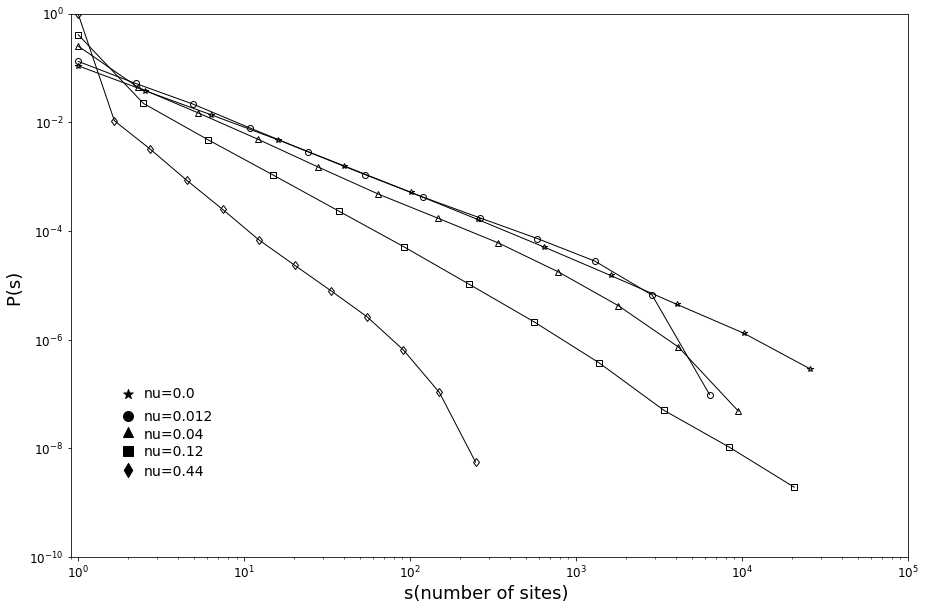

In [5]:
fig=plt.figure(figsize=(15,10))

spec = gridspec.GridSpec(ncols=1, nrows=1)

ax1=fig.add_subplot(spec[0])

s0=1
markers1=['d','s','^','o','*']*nbfile
for j in range(nalpha): 
    if(j<nalpha/nbfile):
        symbols1=markers1[j]+'k-'
        ax1.plot(ndist[j,:,0],ndist[j,:,1],symbols1,linewidth=1,markersize=6,mec="k", mfc="none") 

    

ax1.scatter(2,10**-7,s=100, marker= "*", color ="k")
ax1.text(2.5,8.5*10**-8, 'nu=0.0', fontsize=14)
ax1.scatter(2,4*10**-8,s=100, marker= "o", color ="k")
ax1.text(2.5,3.2*10**-8, 'nu=0.012', fontsize=14)
ax1.scatter(2,2*10**-8,s=100, marker= "^", color ="k")
ax1.text(2.5,1.5*10**-8, 'nu=0.04', fontsize=14)
ax1.scatter(2,9*10**-9,s=100, marker= "s", color ="k")
ax1.text(2.5,7.5*10**-9, 'nu=0.12', fontsize=14)
ax1.scatter(2,4*10**-9,s=100, marker= "d", color ="k")
ax1.text(2.5,3.2*10**-9, 'nu=0.44', fontsize=14)


    
ax1.axis([9*10**-1, 10**5, 10**-10, 1])
ax1.set_xscale("log")
ax1.set_yscale("log")
ax1.set_xlabel('s(number of sites) ', fontsize=18)
ax1.set_ylabel('P(s) ', fontsize=18)
ax1.tick_params(labelsize=12) 

In [6]:
foldername = [1,2,3,4,5]
time=np.array([1e6,5e6,1e7])

file = f"{brutpath}/Re7"


snapshot=np.zeros((len(foldername),len(time) , L*L))


for i, term in enumerate(foldername):
    for x, t in enumerate (time):
        f=open(f"{file}{term}/nav{int(t)}_outputB.txt")
        for j, line in enumerate (f) :
            snapshot[i][x][j]=line
            j+=1


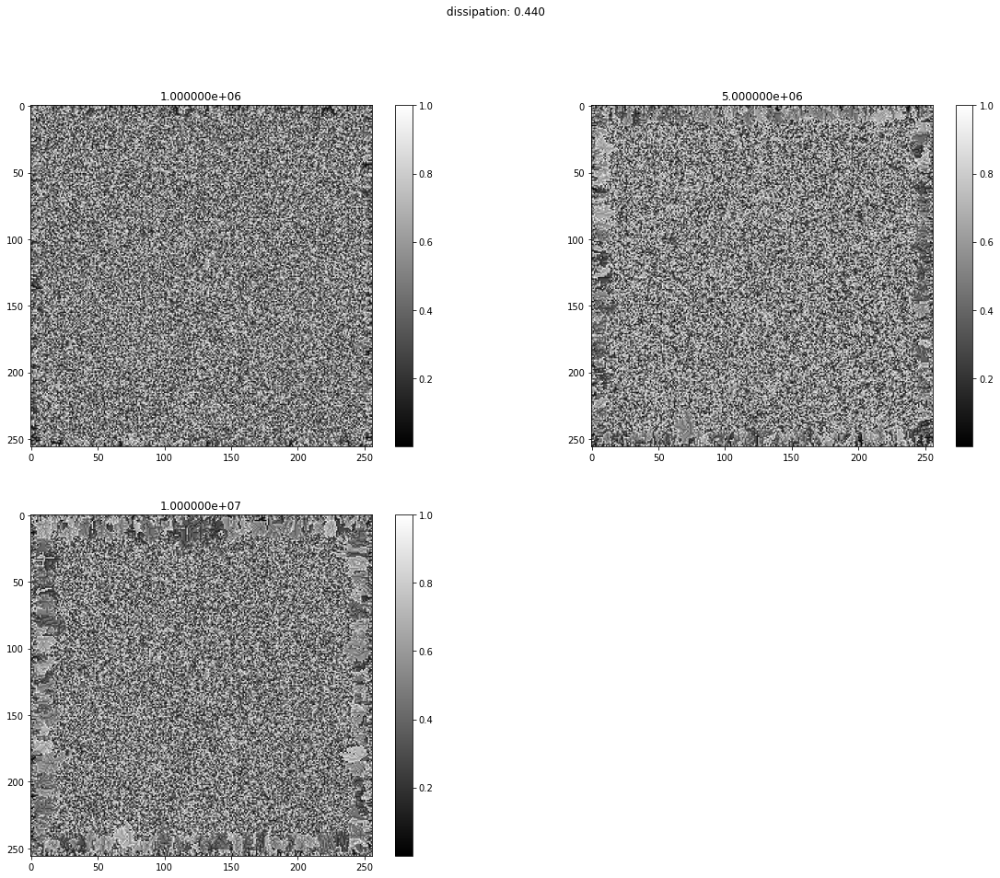

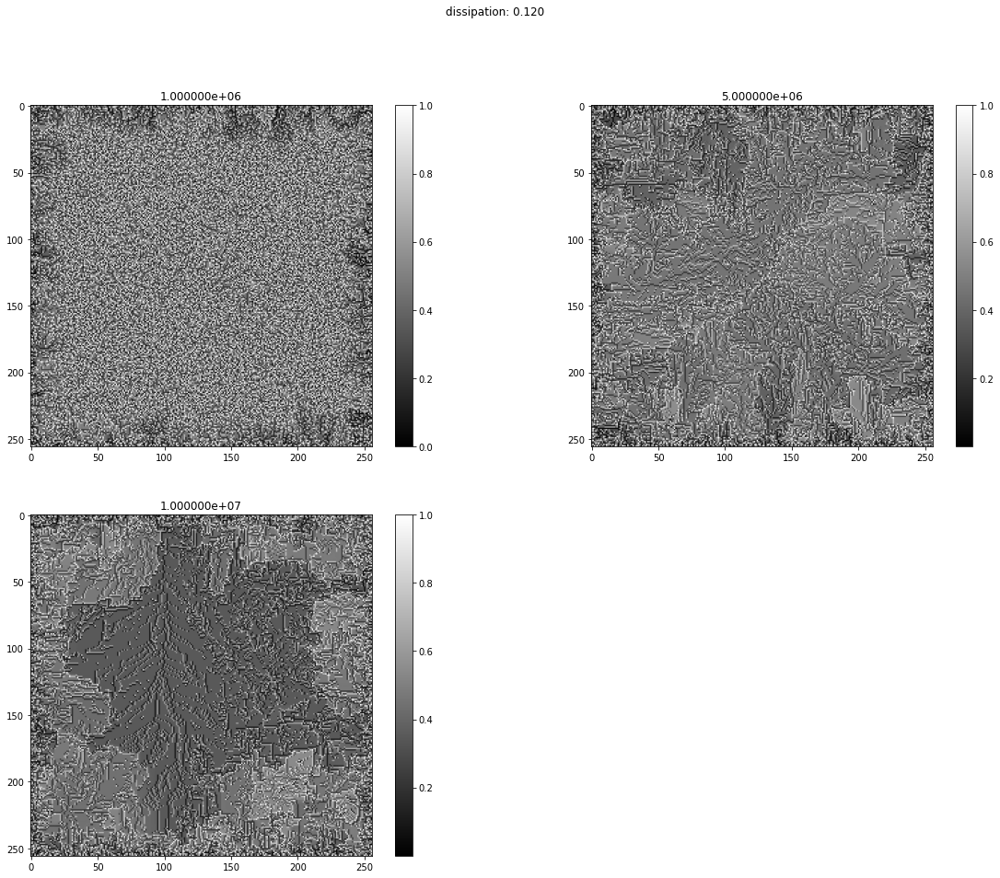

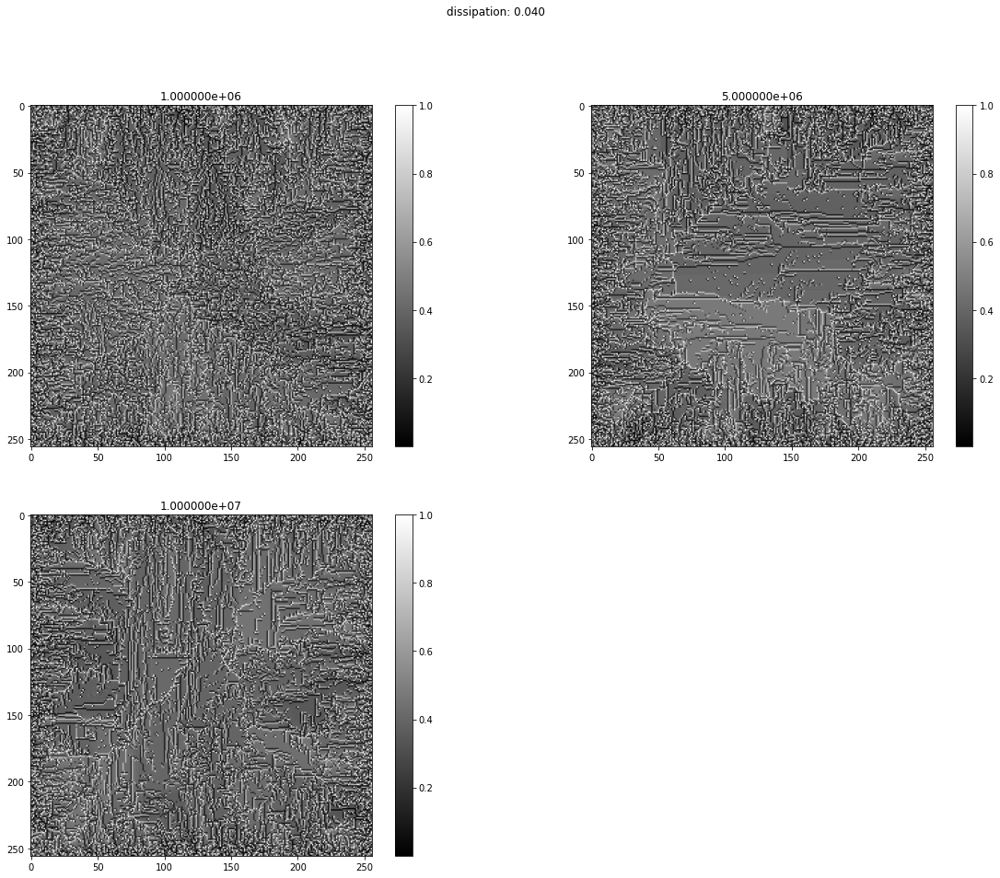

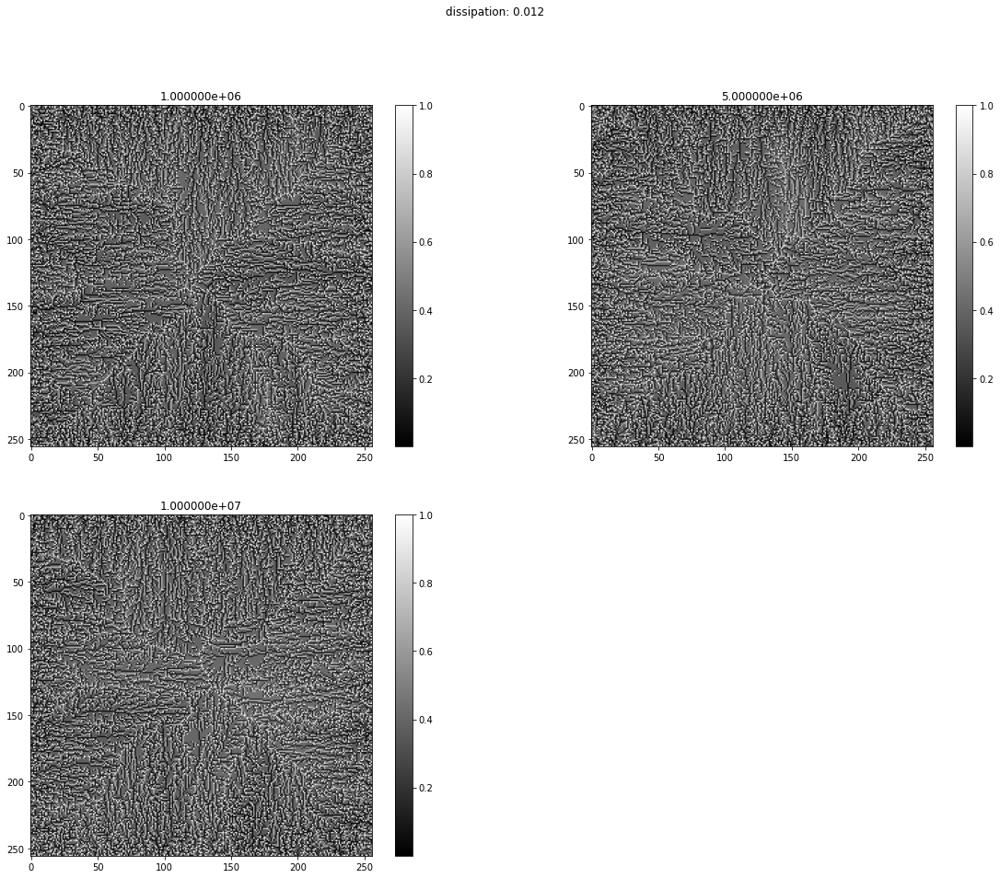

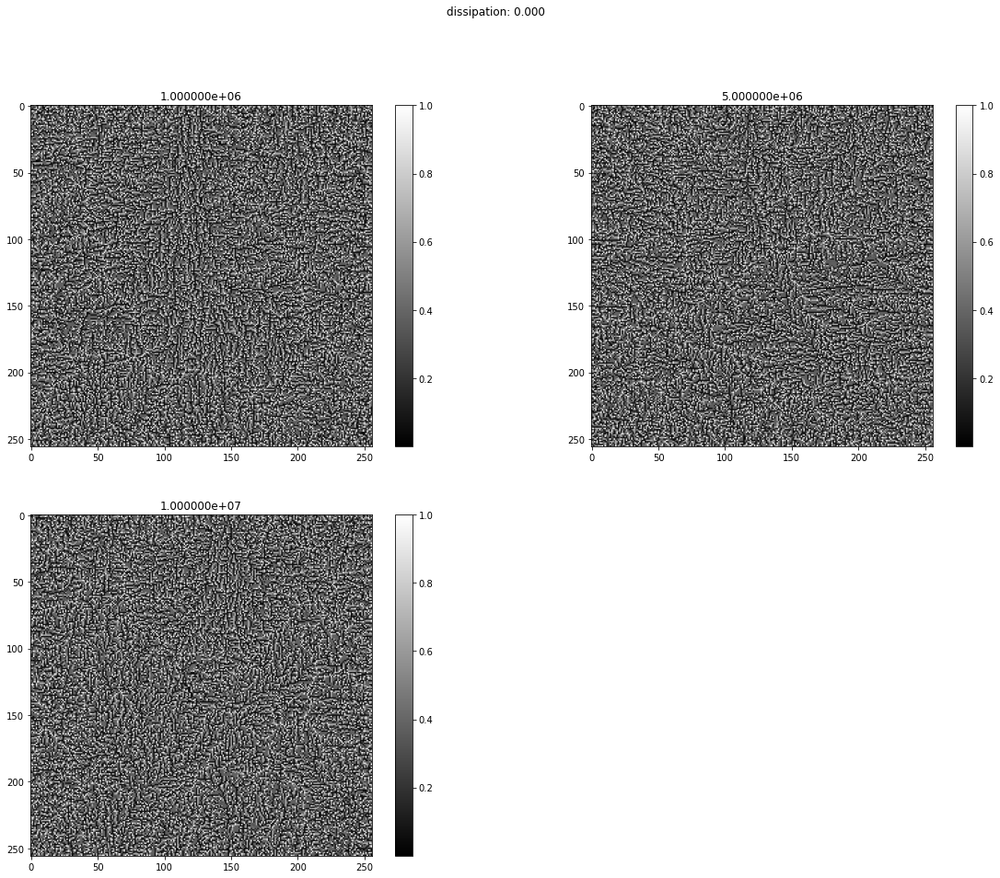

In [7]:
sys=np.zeros((len(foldername),len(time),L,L))


for i in range(len(foldername)):
    for j in range(len(time)):
        for n in range (L*L):
            x1, x2=coorno(n)
            sys[i][j][x1][x2]=snapshot[i][j][n]

        
def figure(tab3D,L,j):
    
    plt.figure(figsize=(20,15))        
    nbfig=len(tab3D)

    for i in range(nbfig):
        plt.subplot(2,2,i+1)
        plt.imshow(tab3D[i], cmap="gray")
        plt.title(f"{time[i]:e}")
        plt.colorbar()
    plt.suptitle(f"dissipation: {1-4*(alpha[j]/ncifras[j]):.3f}")

for i in range (len(foldername)):
    figure(sys[i], L, i)

## Conditions de bords periodiques sur l'axe x2 et ouvert sur l'axe x1

In [66]:
nbfile=1 #nb of different data
alpha=[25,247,24,22, 15]*nbfile #dissipation for each datafile
nalpha=len(alpha)
ncifras=[100,1000,100,100,100]*nbfile #to put in fraction
dim=[2]*nalpha  # Dimension of the sys for each datafile 
nbins=12  #nb of points for the fit
lenghtTab=20*256**2 
nbdisip=int(nalpha/nbfile)

brutpath=f'{datapath}/Brut/Bondary_Condition'

a='{}/Bo1{}'
a2='{}/Bo3{}'
b='/AvalancheB_output.txt'


filetab=[]
casetab=[]
c=1
for i in range(len(alpha)):
        if i == 2:
            filetab.append(a.format(brutpath, 1)+b)
            casetab.append(0)
            continue
        filetab.append(a2.format(brutpath, c)+b)
        casetab.append(0)
        c+=1
            
        

In [67]:
ndatafit2, ndistloglog2, disip2, nstat2, d2=mainfct(alpha, ncifras, dim, lenghtTab, filetab , casetab, nbfile, nbins)
print("mainfct done")

mainfct done


In [68]:
ndist2=10**ndistloglog2
""" xmoy2, ymoy2=avg(ndist2, nalpha, nbfile, nbins)
xstddev, ystddev=stdev(ndist, nalpha, nbfile, nbins, xmoy, ymoy) """

' xmoy2, ymoy2=avg(ndist2, nalpha, nbfile, nbins)\nxstddev, ystddev=stdev(ndist, nalpha, nbfile, nbins, xmoy, ymoy) '

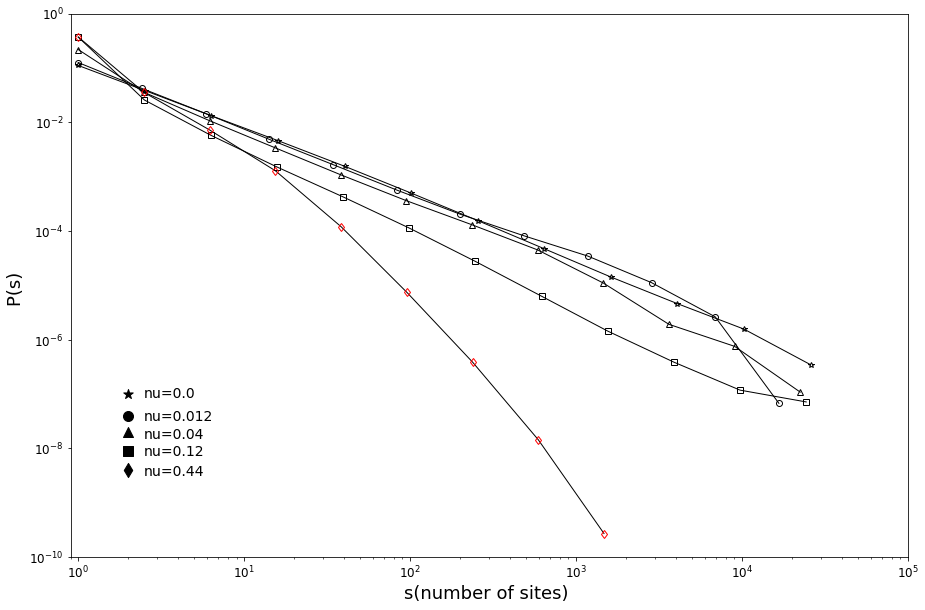

In [69]:
fig=plt.figure(figsize=(15,10))

spec = gridspec.GridSpec(ncols=1, nrows=1)

ax1=fig.add_subplot(spec[0])

s0=1
markers1=['*','o','^','s','d']*nbfile
for j in range(nalpha): 
    if(j<nalpha/nbfile):
        symbols1=markers1[j]+'k-'
        if(j == 4):
            ax1.plot(ndist2[j,:9,0],ndist2[j,:9,1],symbols1,linewidth=1,markersize=6,mec="r", mfc="none")
        else :
            ax1.plot(ndist2[j,:,0],ndist2[j,:,1],symbols1,linewidth=1,markersize=6,mec="k", mfc="none") 

    

ax1.scatter(2,10**-7,s=100, marker= "*", color ="k")
ax1.text(2.5,8.5*10**-8, 'nu=0.0', fontsize=14)
ax1.scatter(2,4*10**-8,s=100, marker= "o", color ="k")
ax1.text(2.5,3.2*10**-8, 'nu=0.012', fontsize=14)
ax1.scatter(2,2*10**-8,s=100, marker= "^", color ="k")
ax1.text(2.5,1.5*10**-8, 'nu=0.04', fontsize=14)
ax1.scatter(2,9*10**-9,s=100, marker= "s", color ="k")
ax1.text(2.5,7.5*10**-9, 'nu=0.12', fontsize=14)
ax1.scatter(2,4*10**-9,s=100, marker= "d", color ="k")
ax1.text(2.5,3.2*10**-9, 'nu=0.44', fontsize=14)


    
ax1.axis([9*10**-1, 10**5, 10**-10, 1])
ax1.set_xscale("log")
ax1.set_yscale("log")
ax1.set_xlabel('s(number of sites) ', fontsize=18)
ax1.set_ylabel('P(s) ', fontsize=18)
ax1.tick_params(labelsize=12) 

In [12]:
            
foldername = [1,2,1,3,4]
time=np.array([1e6,5e6,1e7])

file = f"{brutpath}/Bo3"
file2 = f"{brutpath}/Bo1"

snapshot=np.zeros((len(foldername),len(time) , L*L))


for i, term in enumerate(foldername):
    for x, t in enumerate (time):
        if i == 2: 
            f=open(f"{file2}{term}/nav{int(t)}_outputB.txt")
        else: 
            f=open(f"{file}{term}/nav{int(t)}_outputB.txt")
        
        j = 0 
        for line in f :
            if not line.startswith('#'):
                col = line.strip().split("  ")
                snapshot[i][x][j]=col[0]
                j+=1
            


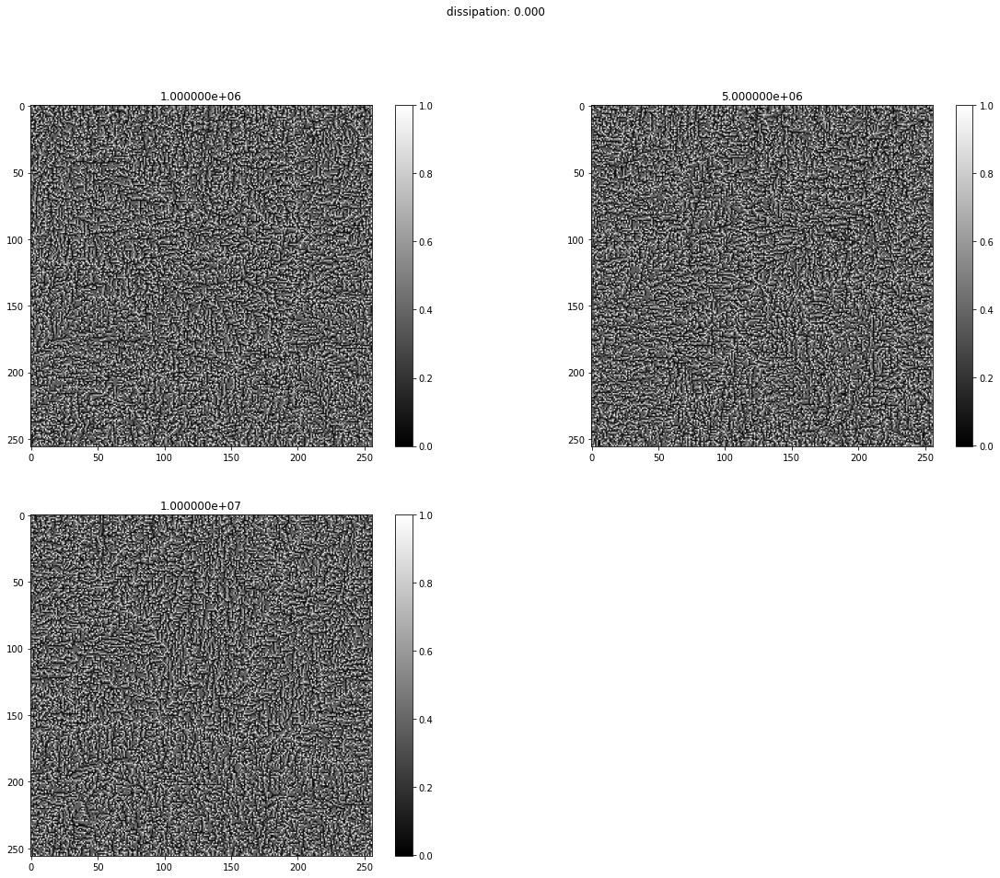

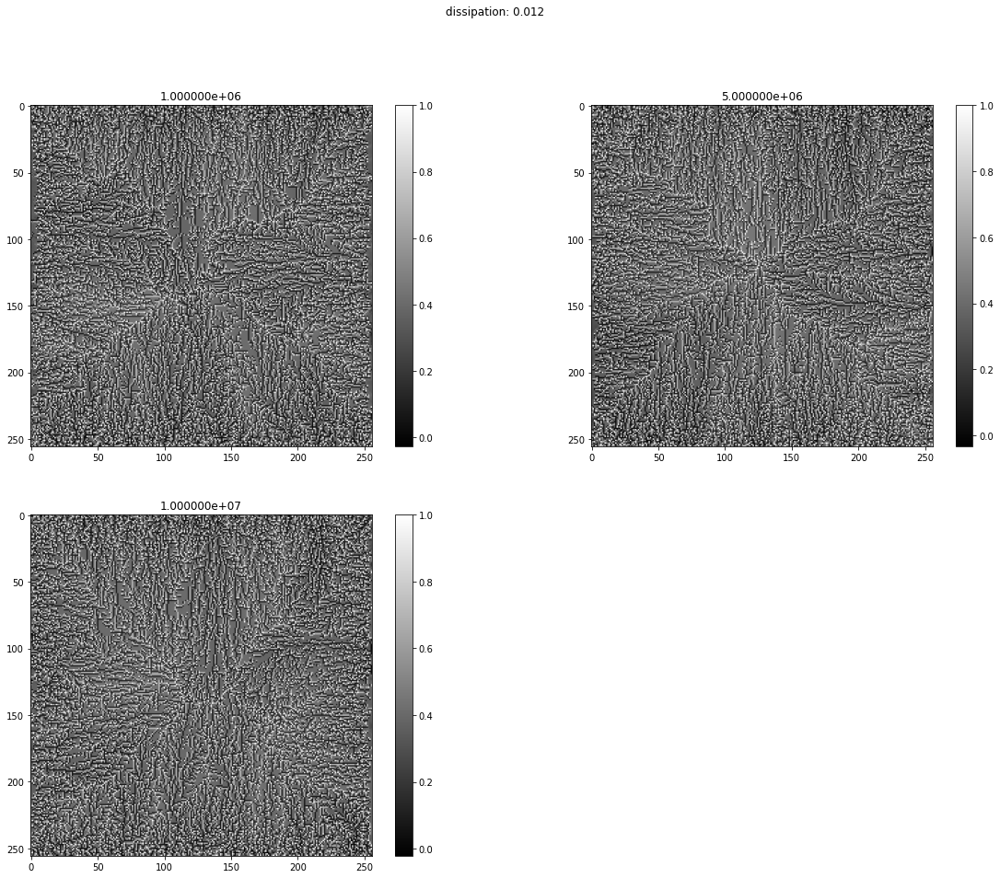

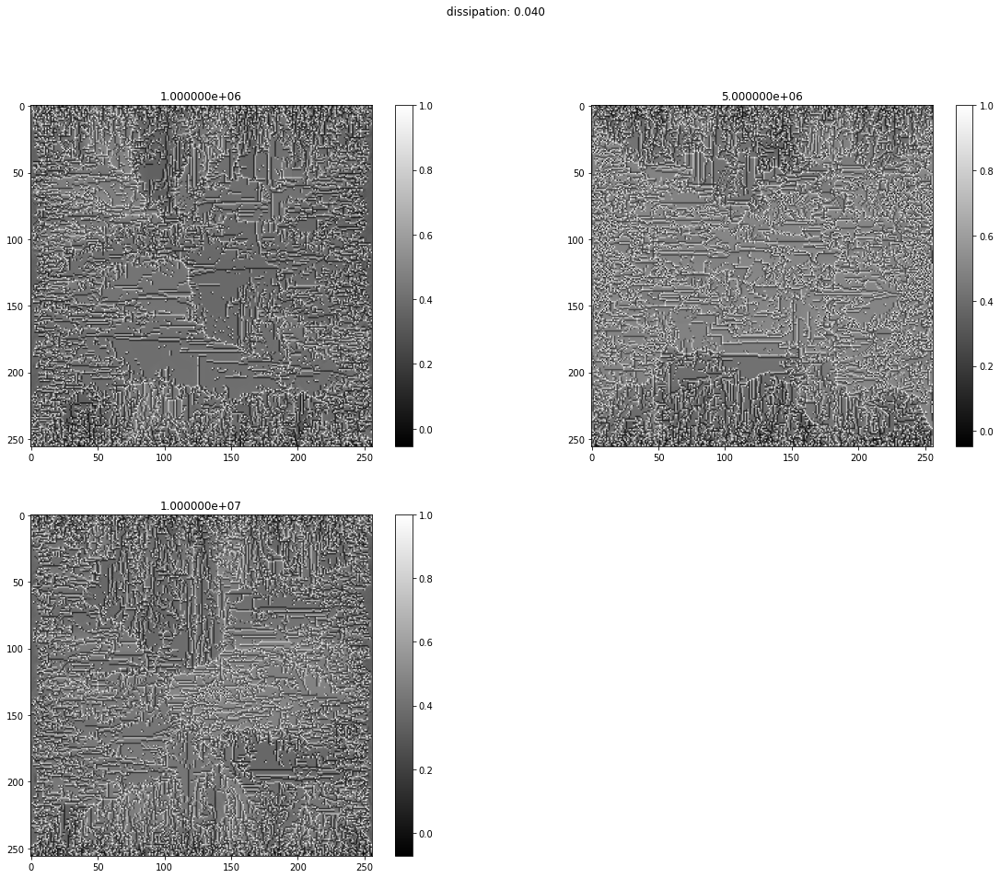

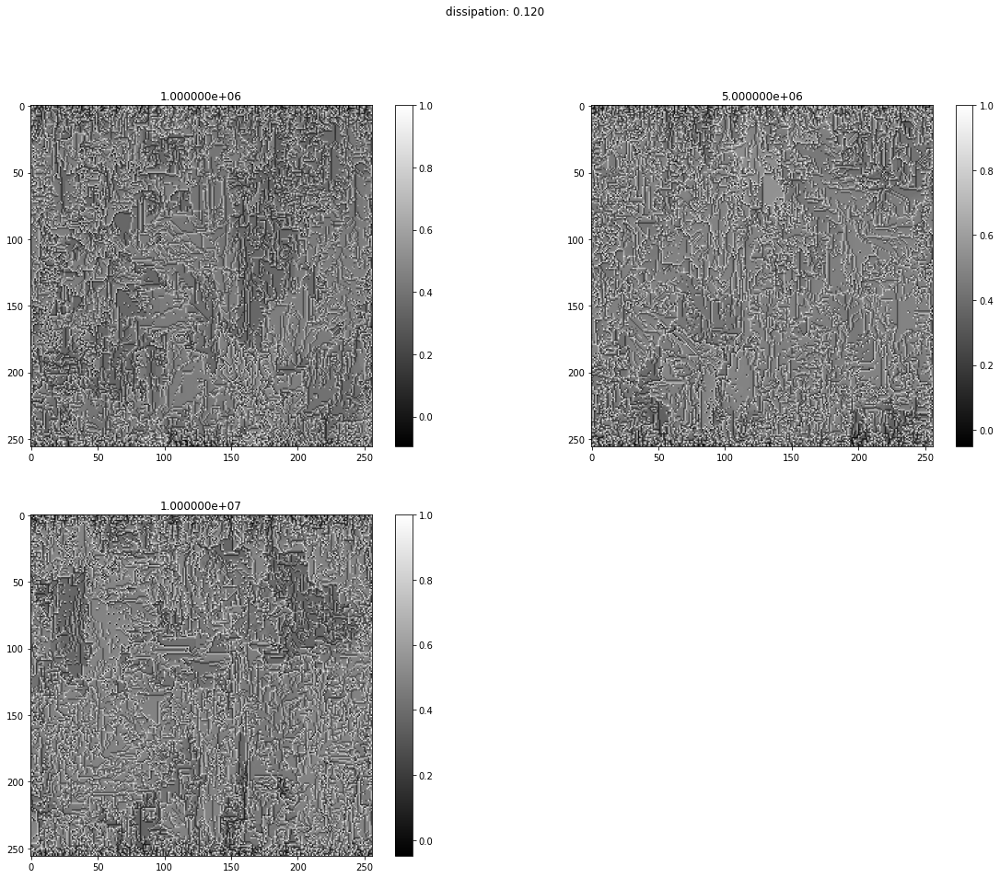

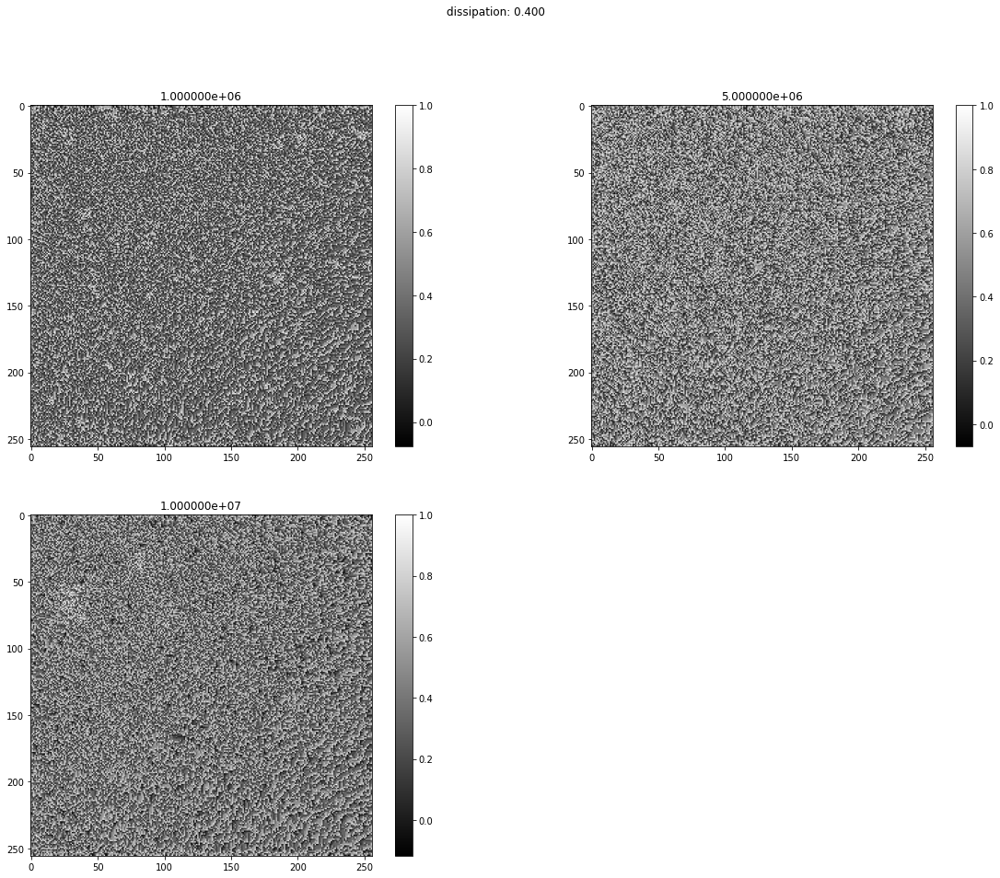

In [13]:
sys=np.zeros((len(foldername),len(time),L,L))


for i in range(len(foldername)):
    for j in range(len(time)):
        for n in range (L*L):
            x1, x2=coorno(n)
            sys[i][j][x1][x2]=snapshot[i][j][n]

        
def figure(tab3D,L,j):
    
    plt.figure(figsize=(20,15))        
    nbfig=len(tab3D)

    for i in range(nbfig):
        plt.subplot(2,2,i+1)
        plt.imshow(tab3D[i], cmap="gray")
        plt.title(f"{time[i]:e}")
        plt.colorbar()
    plt.suptitle(f"dissipation: {1-4*(alpha[j]/ncifras[j]):.3f}")

for i in range (len(foldername)):
    figure(sys[i], L, i)

## Conditions de bords periodiques sur l'axe x2 ouvert dans la direction positive sur l'axe x1 et reflective dans la direction negative de x1

In [74]:
nbfile=1 #nb of different data
alpha=[25,247,24,22,15]*nbfile #dissipation for each datafile
nalpha=len(alpha)
ncifras=[100,1000,100,100,100]*nbfile #to put in fraction
dim=[2]*nalpha  # Dimension of the sys for each datafile 
nbins=12  #nb of points for the fit
lenghtTab=20*256**2 
nbdisip=int(nalpha/nbfile)

brutpath=f'{datapath}/Brut/Bondary_Condition'

a='{}/Bo2{}'
a2='{}/Bo4{}'
b='/AvalancheB_output.txt'


filetab=[]
casetab=[]
c=1
for i in range(len(alpha)):
    if i == 2:
        filetab.append(a.format(brutpath, 1)+b)
        casetab.append(0)
        continue
    filetab.append(a2.format(brutpath, c)+b)
    casetab.append(0)
    c+=1
        

In [75]:
ndatafit3, ndistloglog3, disip3, nstat3, d3=mainfct(alpha, ncifras, dim, lenghtTab, filetab , casetab, nbfile, nbins)
print("mainfct done")

mainfct done


In [76]:
ndist3=10**ndistloglog3

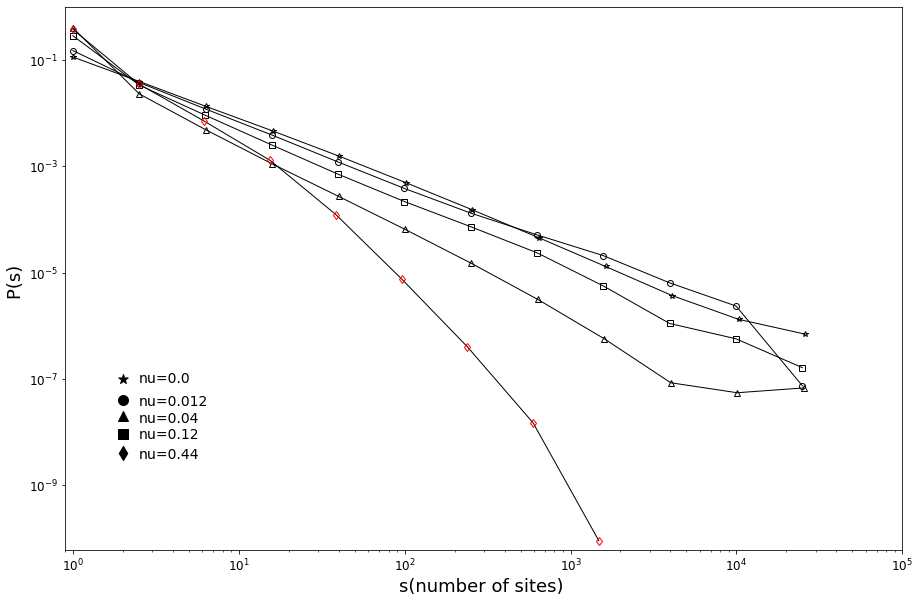

In [72]:
fig=plt.figure(figsize=(15,10))

spec = gridspec.GridSpec(ncols=1, nrows=1)

ax1=fig.add_subplot(spec[0])

s0=1
markers1=['*','o','^','s','d']*nbfile
for j in range(nalpha): 
    if(j<nalpha/nbfile):
        symbols1=markers1[j]+'k-'
        if(j == 4):
            ax1.plot(ndist3[j,:9,0],ndist3[j,:9,1],symbols1,linewidth=1,markersize=6,mec="r", mfc="none")
        else:
            ax1.plot(ndist3[j,:,0],ndist3[j,:,1],symbols1,linewidth=1,markersize=6,mec="k", mfc="none") 

ax1.scatter(2,10**-7,s=100, marker= "*", color ="k")
ax1.text(2.5,8.5*10**-8, 'nu=0.0', fontsize=14)
ax1.scatter(2,4*10**-8,s=100, marker= "o", color ="k")
ax1.text(2.5,3.2*10**-8, 'nu=0.012', fontsize=14)
ax1.scatter(2,2*10**-8,s=100, marker= "^", color ="k")
ax1.text(2.5,1.5*10**-8, 'nu=0.04', fontsize=14)
ax1.scatter(2,9*10**-9,s=100, marker= "s", color ="k")
ax1.text(2.5,7.5*10**-9, 'nu=0.12', fontsize=14)
ax1.scatter(2,4*10**-9,s=100, marker= "d", color ="k")
ax1.text(2.5,3.2*10**-9, 'nu=0.44', fontsize=14)


    
ax1.axis([9e-1, 1e5, 6e-11, 1])
ax1.set_xscale("log")
ax1.set_yscale("log")
ax1.set_xlabel('s(number of sites) ', fontsize=18)
ax1.set_ylabel('P(s) ', fontsize=18)
ax1.tick_params(labelsize=12) 

In [ ]:
foldername = [1,2,1,3,4]
time=np.array([1e6, 5e6,1e7])

file = f"{brutpath}/Bo4"
file2 = f"{brutpath}/Bo2"

snapshot=np.zeros((len(foldername),len(time) , L*L))


for i, term in enumerate(foldername):
    for x, t in enumerate (time):
        if i == 2: 
            f=open(f"{file2}{term}/nav{int(t)}_outputB.txt")
        else: 
            f=open(f"{file}{term}/nav{int(t)}_outputB.txt")
        
        j = 0 
        for line in f :
            if not line.startswith('#'):
                col = line.strip().split("  ")
                snapshot[i][x][j]=col[0]
                j+=1
            

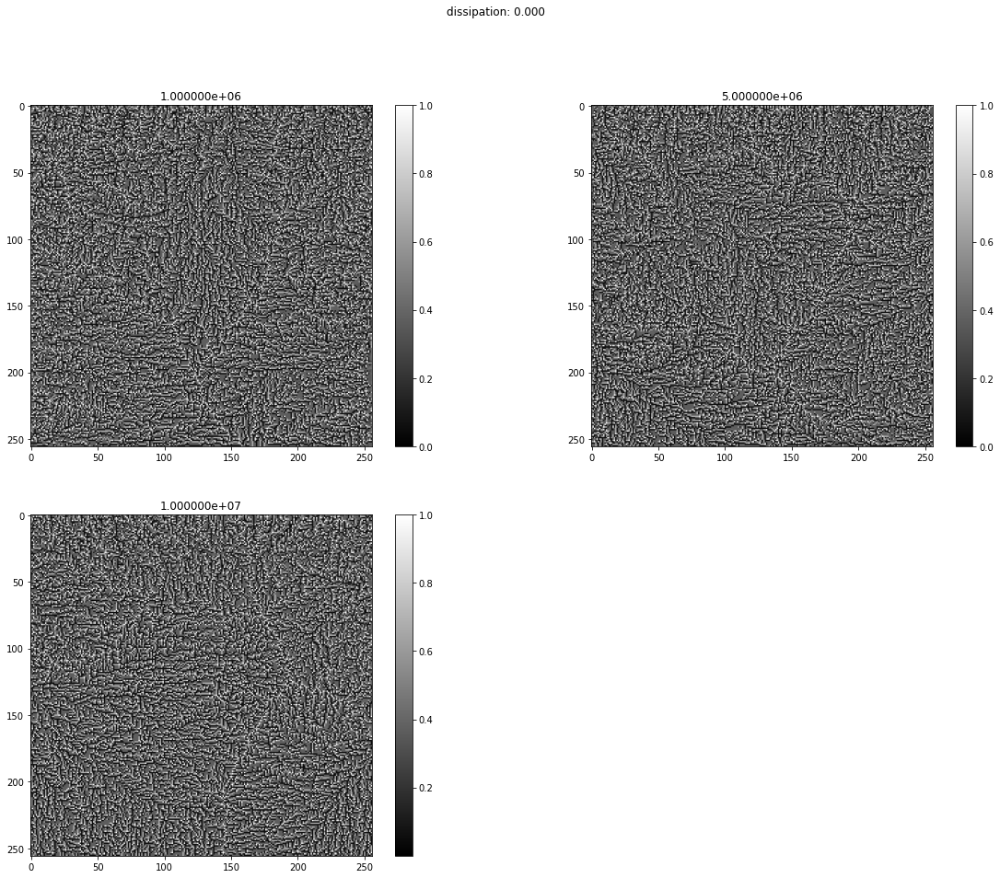

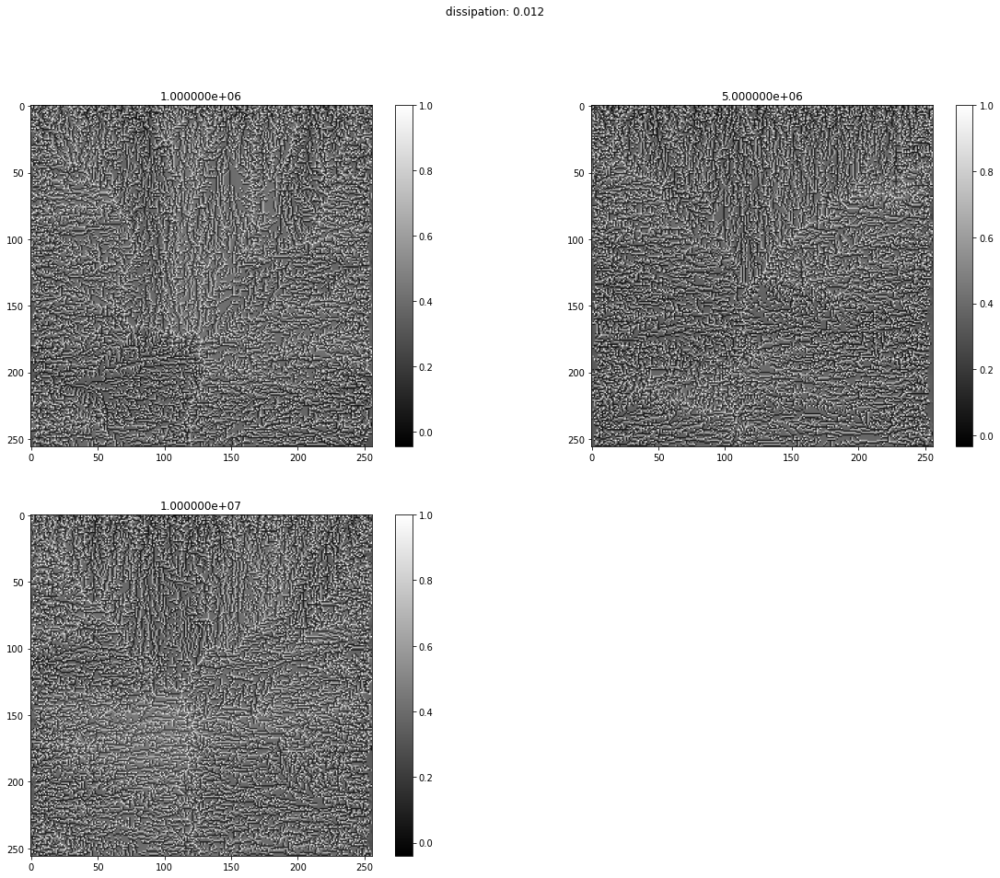

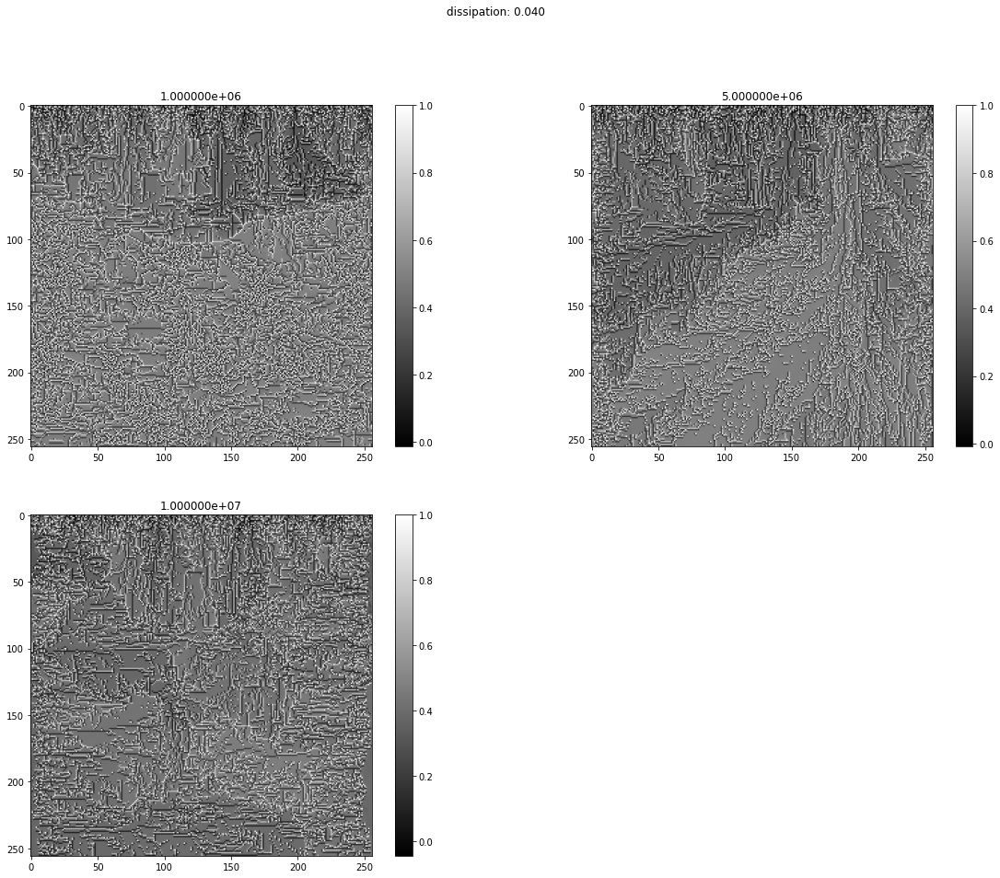

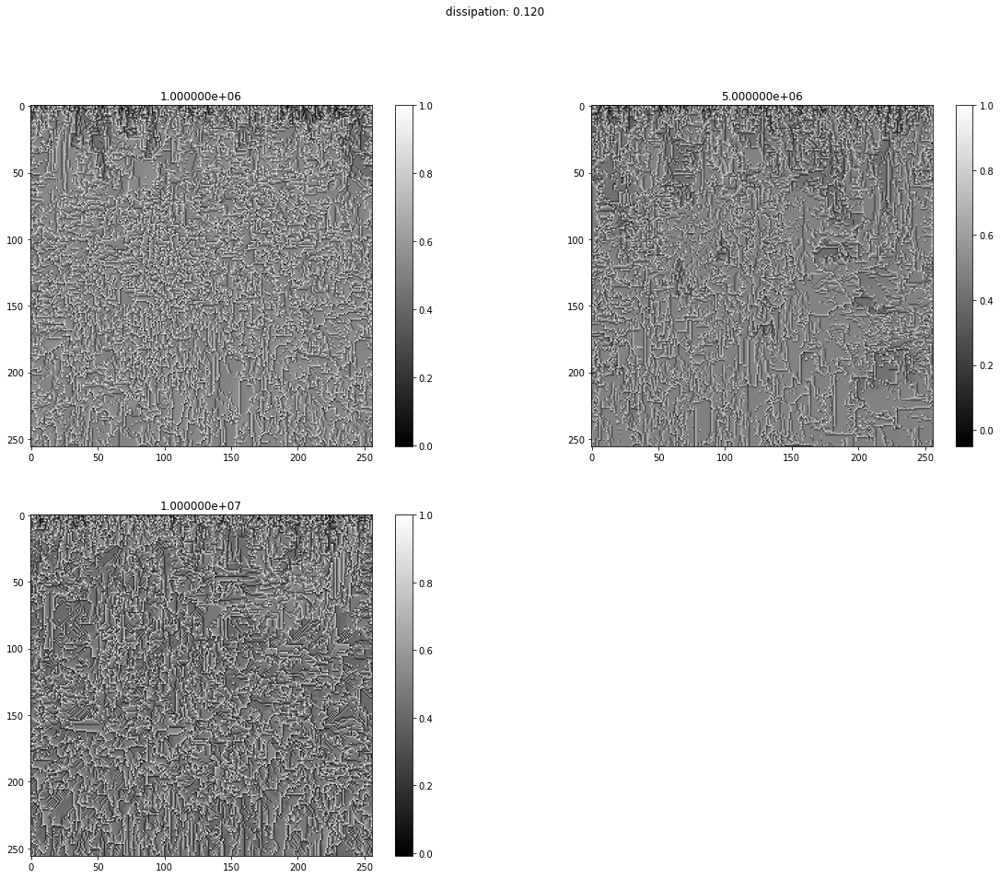

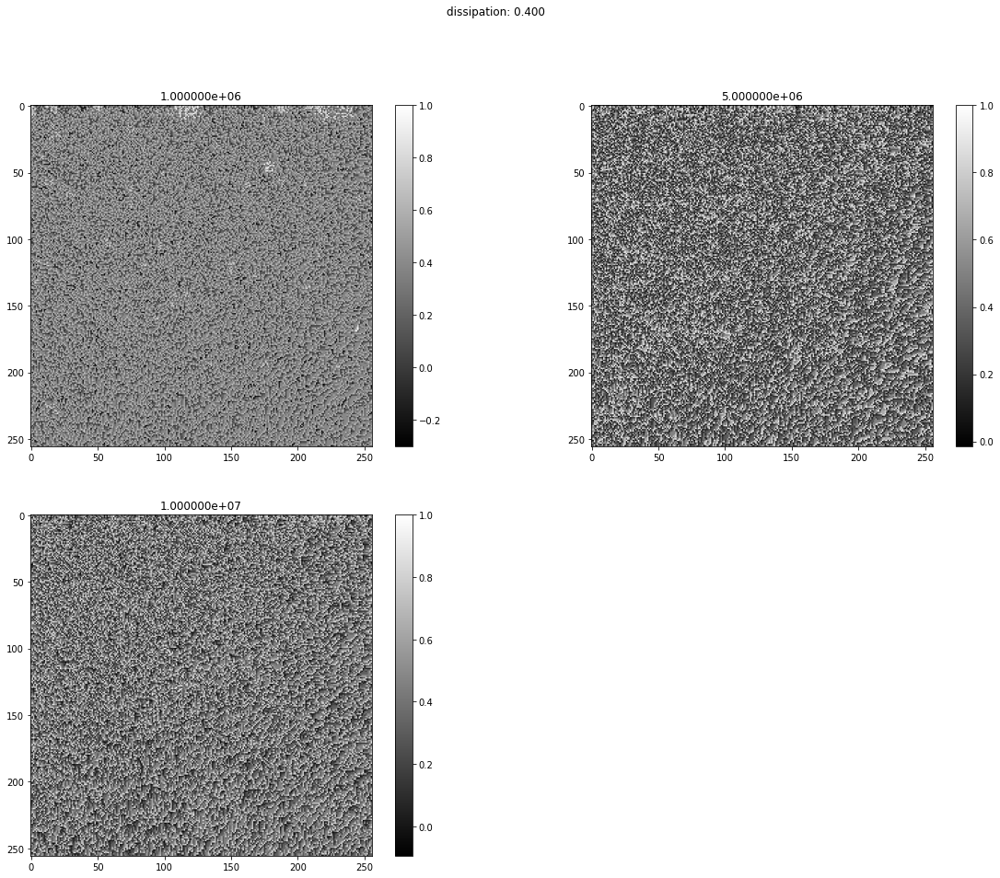

In [ ]:
sys=np.zeros((len(foldername),len(time),L,L))


for i in range(len(foldername)):
    for j in range(len(time)):
        for n in range (L*L):
            x1, x2=coorno(n)
            sys[i][j][x1][x2]=snapshot[i][j][n]

        
def figure(tab3D,L,j):
    
    plt.figure(figsize=(20,15))        
    nbfig=len(tab3D)

    for i in range(nbfig):
        plt.subplot(2,2,i+1)
        plt.imshow(tab3D[i], cmap="gray")
        plt.title(f"{time[i]:e}")
        plt.colorbar()
    plt.suptitle(f"dissipation: {1-4*(alpha[j]/ncifras[j]):.3f}")

for i in range (len(foldername)):
    figure(sys[i], L, i)

Dans le cas periodique et reflectif à très faible dissipation on a le cut-off qui apparaît et qui redisparait quand on continue d'augmenter la dissipation. 
(Note: Refaire une simu à 0.02 pour s'assurer de l'évolution du cut-off)
Dans les snapshots on voit des patches mais rien qui indique comment ils se forment après 1e6 ava.
(Note: Voir ce qui se passe avant 1e6 ava )

#### Que se passe-t-il avant 1e6 avalanche?

#### Cas periodique

In [53]:
foldername = [1,2,3,4,5]
time=np.array([2e4, 6e4,1e5])

brutpath=f'{datapath}/Brut/Bondary_Condition'

file = f"{brutpath}/Bo7"

snapshot=np.zeros((len(foldername),len(time) , L*L))


for i, term in enumerate(foldername):
    for x, t in enumerate (time):
        f=open(f"{file}{term}/nav{int(t)}_outputB.txt")

        j = 0 
        for line in f :
            if not line.startswith('#'):
                col = line.strip().split("  ")
                snapshot[i][x][j]=col[0]
                j+=1

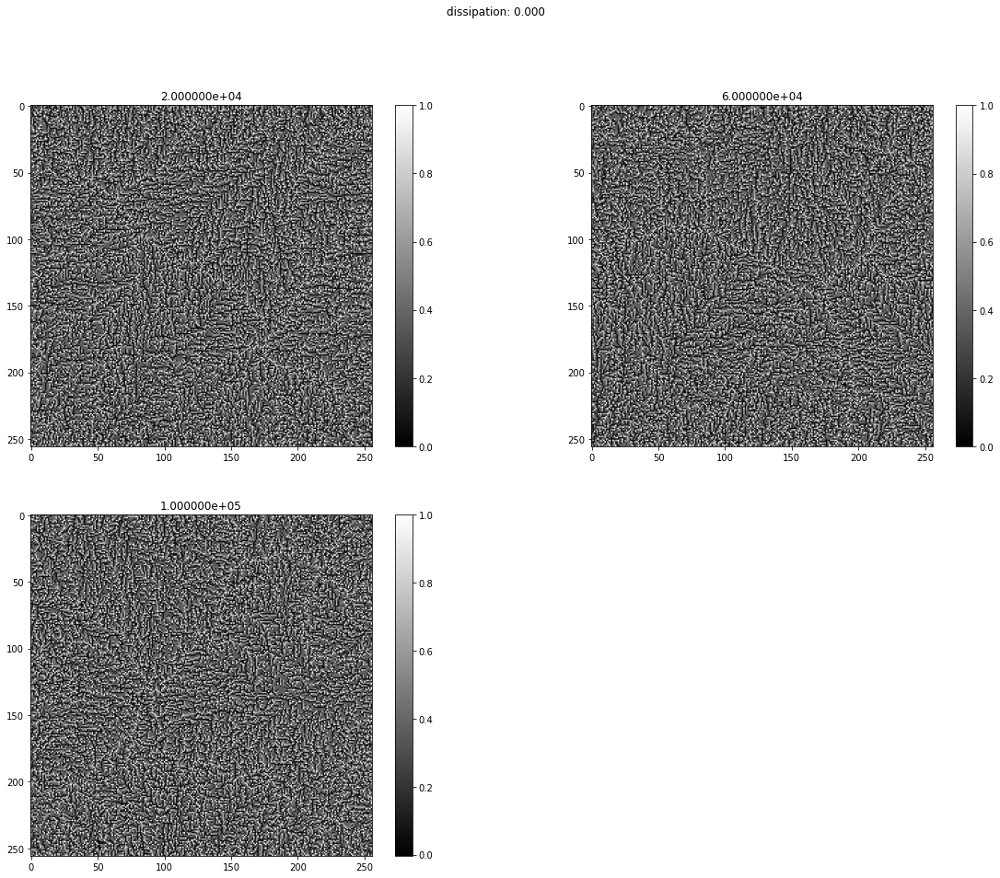

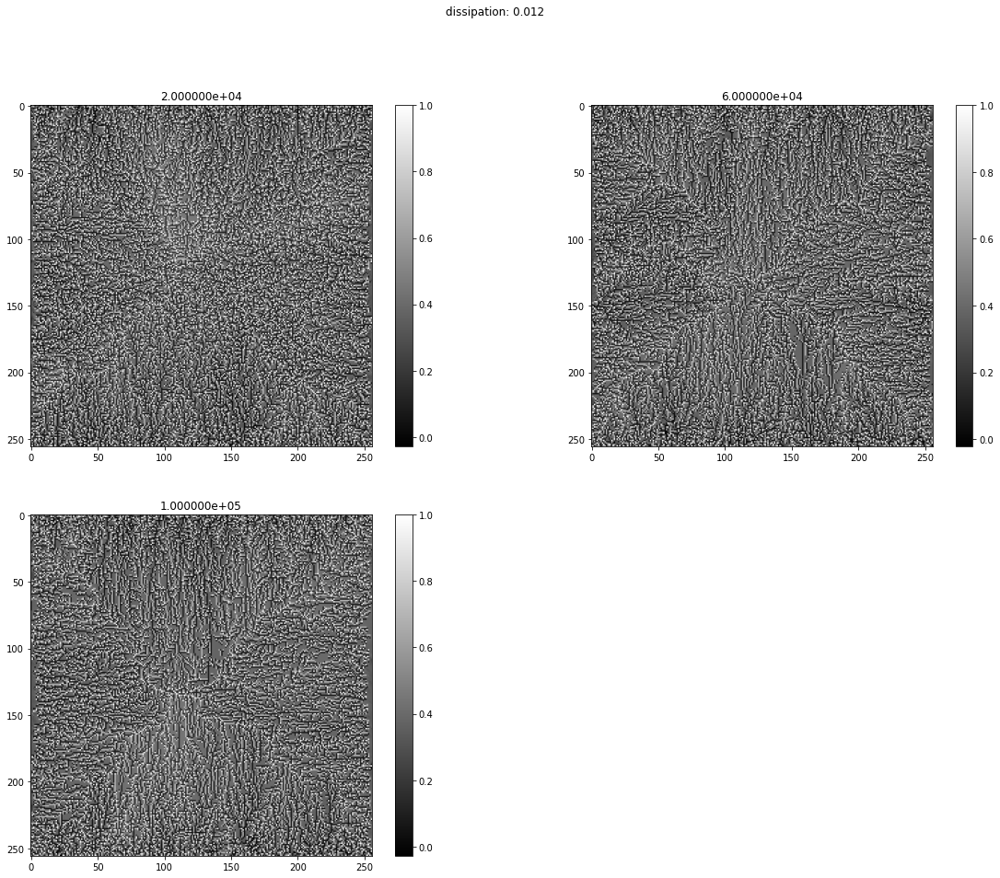

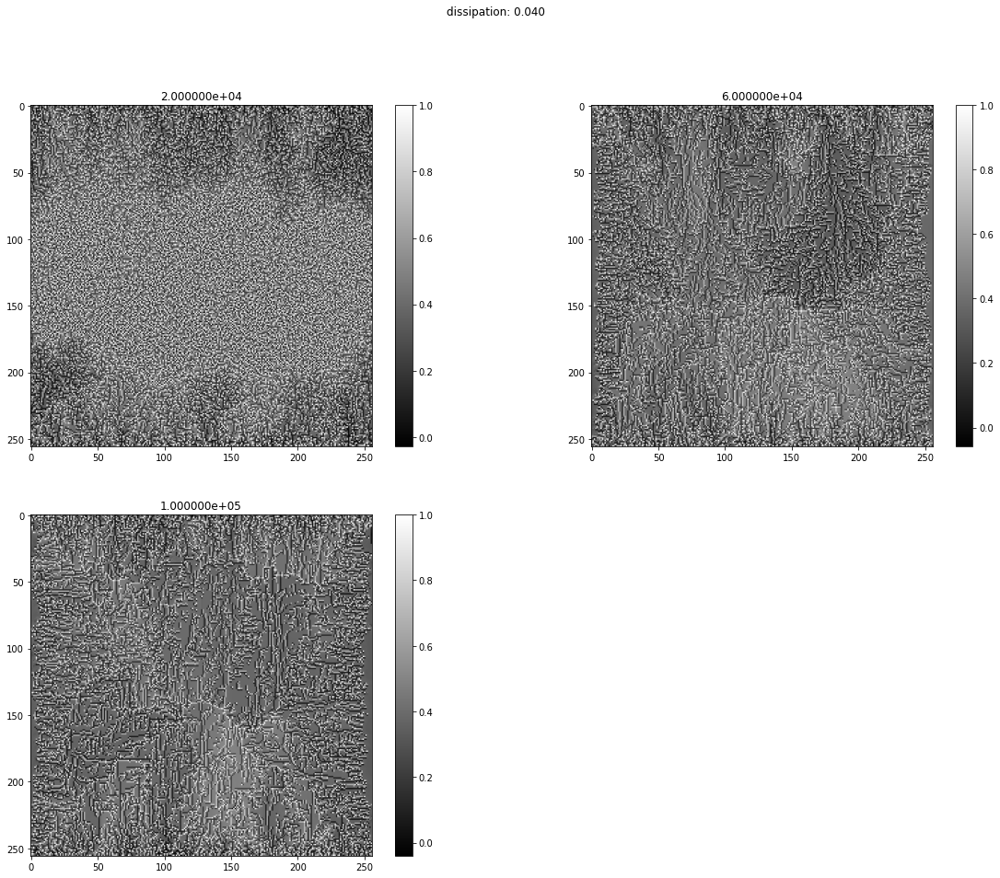

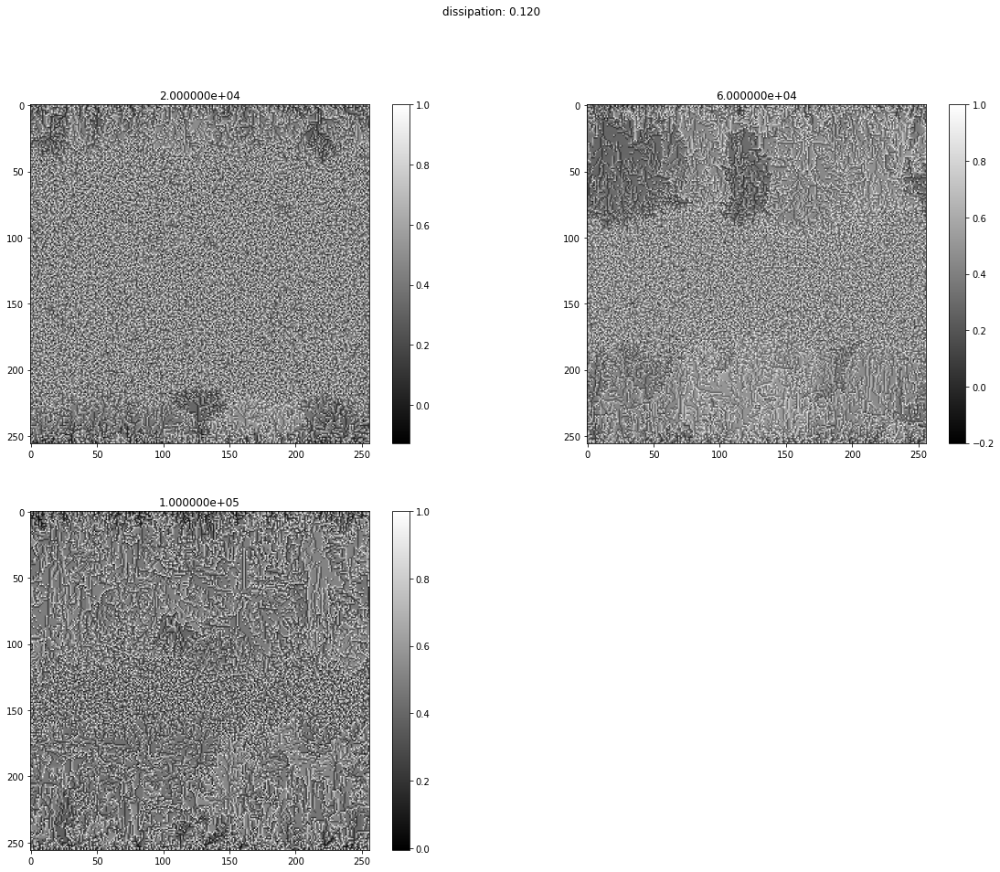

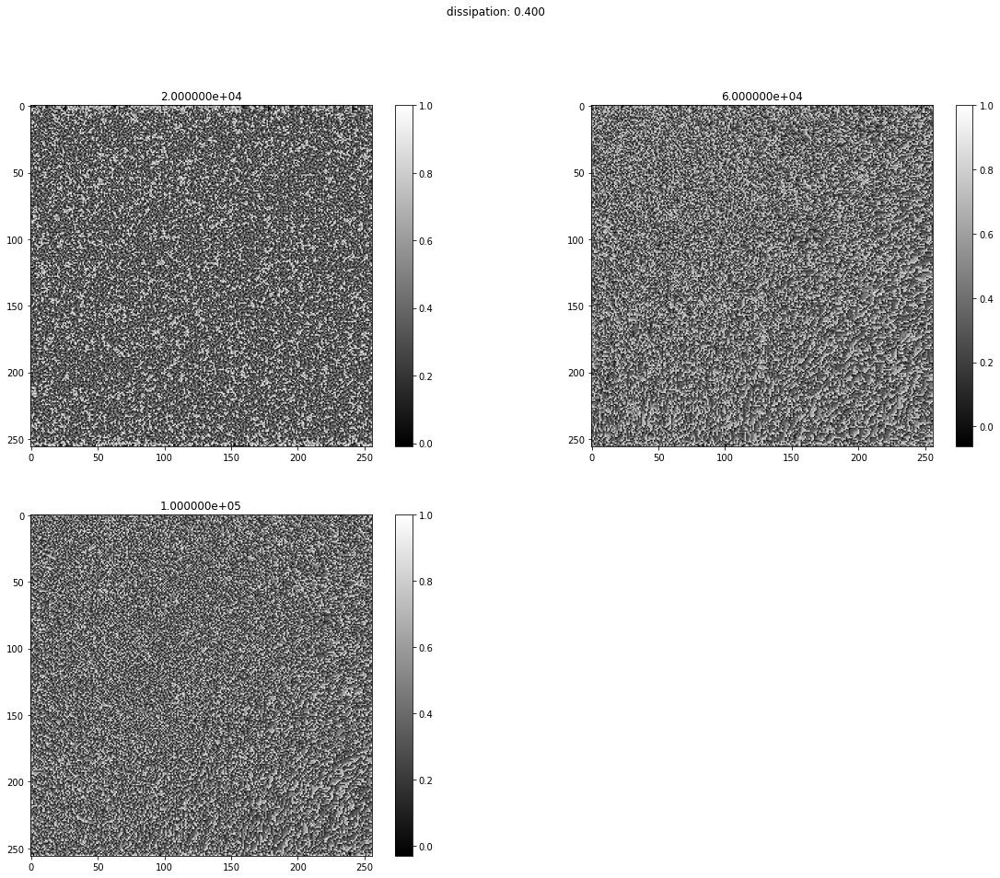

In [54]:
sys=np.zeros((len(foldername),len(time),L,L))


for i in range(len(foldername)):
    for j in range(len(time)):
        for n in range (L*L):
            x1, x2=coorno(n)
            sys[i][j][x1][x2]=snapshot[i][j][n]

        
def figure(tab3D,L,j):
    
    plt.figure(figsize=(20,15))        
    nbfig=len(tab3D)

    for i in range(nbfig):
        plt.subplot(2,2,i+1)
        plt.imshow(tab3D[i], cmap="gray")
        plt.title(f"{time[i]:e}")
        plt.colorbar()
    plt.suptitle(f"dissipation: {1-4*(alpha[j]/ncifras[j]):.3f}")

for i in range (len(foldername)):
    figure(sys[i], L, i)

#### Cas reflectif

In [49]:
foldername = [1,2,3,4,5]
time=np.array([2e5, 4e5,6e5, 8e5])
alpha=[25,247,24,22,15] #dissipation for each datafile
ncifras=[100,1000,100,100,100]#to put in fraction


brutpath=f'{datapath}/Brut/Bondary_Condition'

file = f"{brutpath}/Bo6"

snapshot=np.zeros((len(foldername),len(time) , L*L))


for i, term in enumerate(foldername):
    for x, t in enumerate (time):
        f=open(f"{file}{term}/nav{int(t)}_outputB.txt")

        j = 0 
        for line in f :
            if not line.startswith('#'):
                col = line.strip().split("  ")
                snapshot[i][x][j]=col[0]
                j+=1

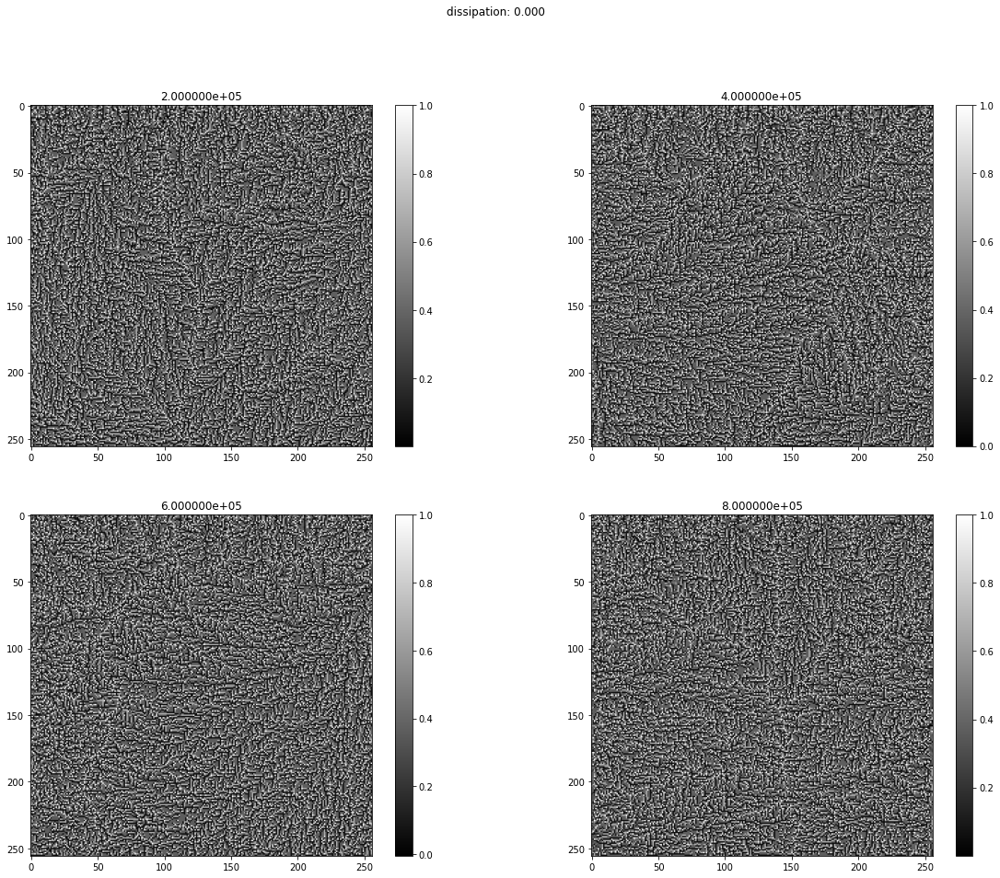

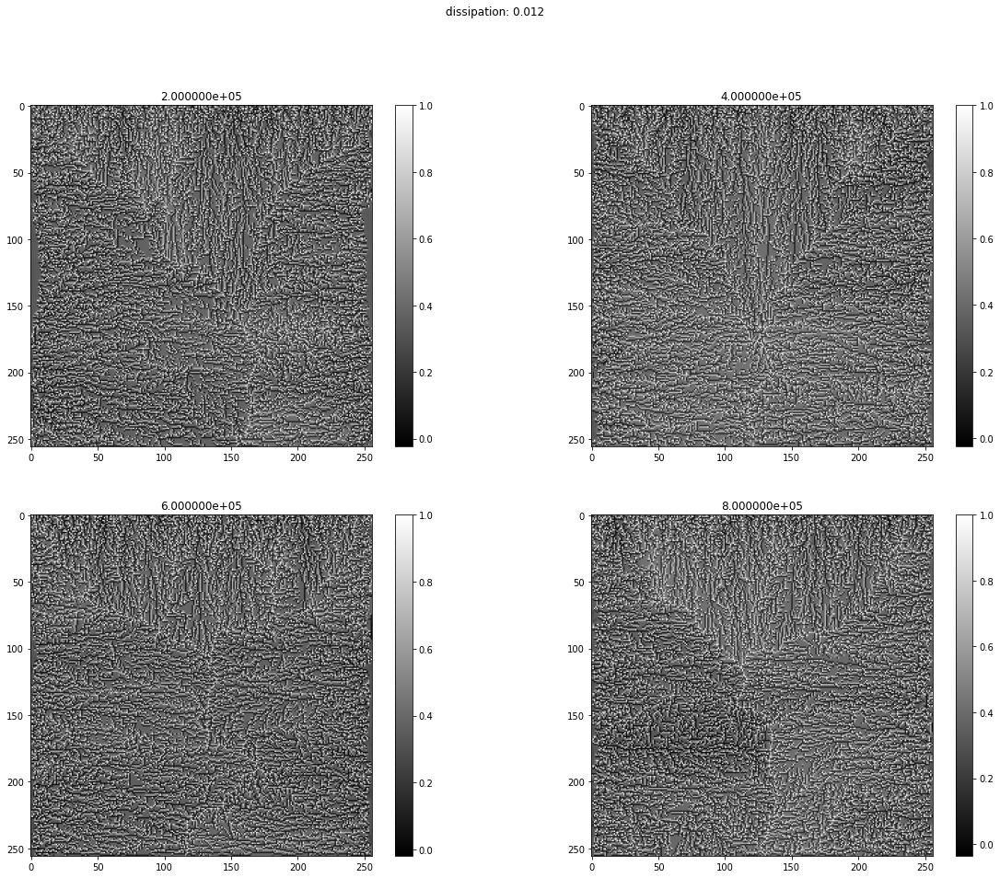

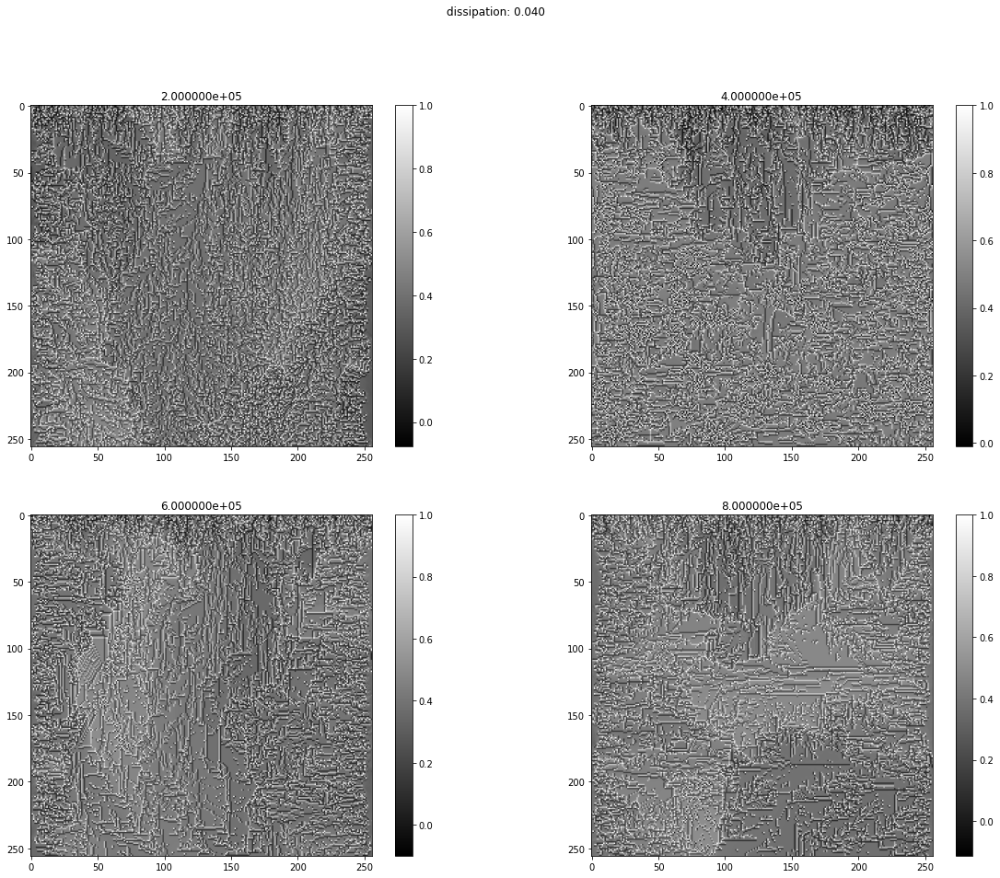

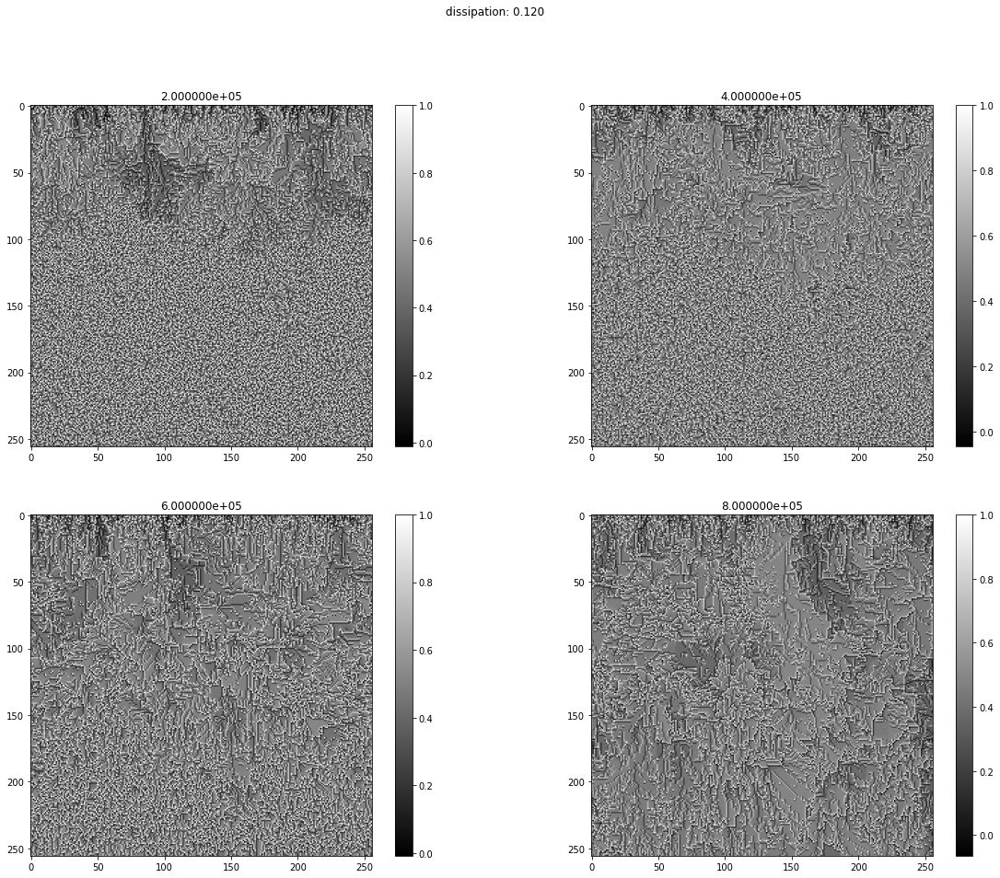

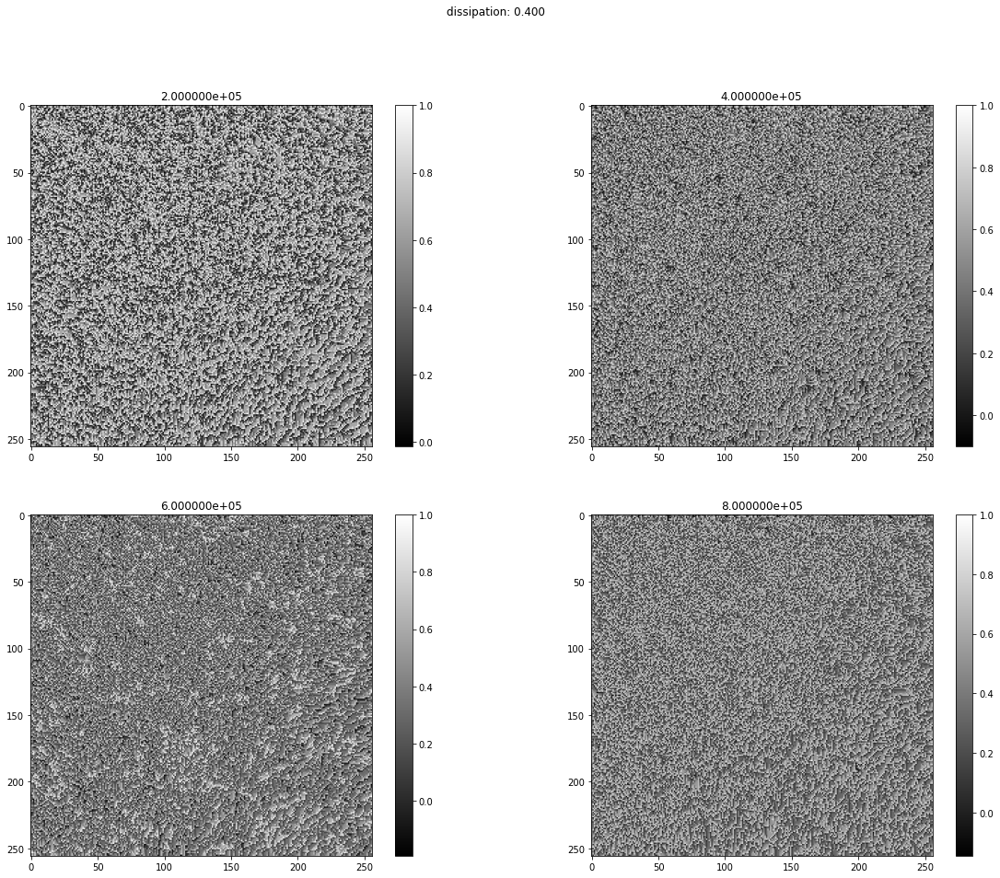

In [50]:
sys=np.zeros((len(foldername),len(time),L,L))


for i in range(len(foldername)):
    for j in range(len(time)):
        for n in range (L*L):
            x1, x2=coorno(n)
            sys[i][j][x1][x2]=snapshot[i][j][n]

        
def figure(tab3D,L,j):
    
    plt.figure(figsize=(20,15))        
    nbfig=len(tab3D)

    for i in range(nbfig):
        plt.subplot(2,2,i+1)
        plt.imshow(tab3D[i], cmap="gray")
        plt.title(f"{time[i]:e}")
        plt.colorbar()
    plt.suptitle(f"dissipation: {1-4*(alpha[j]/ncifras[j]):.3f}")

for i in range (len(foldername)):
    figure(sys[i], L, i)

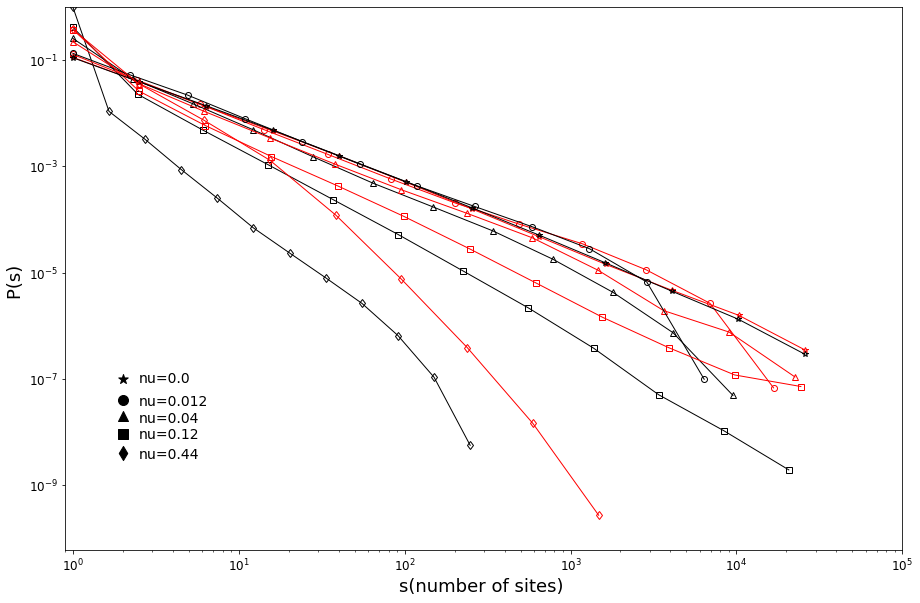

In [73]:
fig=plt.figure(figsize=(15,10))

spec = gridspec.GridSpec(ncols=1, nrows=1)

ax1=fig.add_subplot(spec[0])

s0=1
markers1=['*','o','^','s','d']*nbfile


for j in range(nalpha): 
    if(j<nalpha/nbfile):
        symbols1=markers1[4-j]+'k-'
        symbols2=markers1[j]+'r-'
        symbols3=markers1[j]+'g-'
        if(j == 4):
            """ ax1.plot(ndist[j,:,0],ndist[j,:,1],symbols1,linewidth=1,markersize=6,mec="k", mfc="none") """ 
            ax1.plot(ndist2[j,:9,0],ndist2[j,:9,1],symbols2,linewidth=1,markersize=6,mec="r", mfc="none")
            ax1.plot(ndist3[j,:9,0],ndist3[j,:9,1],symbols3,linewidth=1,markersize=6,mec="g", mfc="none")
        else:
            """ ax1.plot(ndist[j,:,0],ndist[j,:,1],symbols1,linewidth=1,markersize=6,mec="k", mfc="none") """ 
            ax1.plot(ndist2[j,:,0],ndist2[j,:,1],symbols2,linewidth=1,markersize=6,mec="r", mfc="none")
            ax1.plot(ndist3[j,:,0],ndist3[j,:,1],symbols3,linewidth=1,markersize=6,mec="g", mfc="none")

ax1.scatter(2,10**-7,s=100, marker= "*", color ="k")
ax1.text(2.5,8.5*10**-8, 'nu=0.0', fontsize=14)
ax1.scatter(2,4*10**-8,s=100, marker= "o", color ="k")
ax1.text(2.5,3.2*10**-8, 'nu=0.012', fontsize=14)
ax1.scatter(2,2*10**-8,s=100, marker= "^", color ="k")
ax1.text(2.5,1.5*10**-8, 'nu=0.04', fontsize=14)
ax1.scatter(2,9*10**-9,s=100, marker= "s", color ="k")
ax1.text(2.5,7.5*10**-9, 'nu=0.12', fontsize=14)
ax1.scatter(2,4*10**-9,s=100, marker= "d", color ="k")
ax1.text(2.5,3.2*10**-9, 'nu=0.44', fontsize=14)


    
ax1.axis([9e-1, 1e5, 6e-11, 1])
ax1.set_xscale("log")
ax1.set_yscale("log")
ax1.set_xlabel('s(number of sites) ', fontsize=18)
ax1.set_ylabel('P(s) ', fontsize=18)
ax1.tick_params(labelsize=12) 

## Conclusion:

Les patches se forment toujours à partir du bord ouvert et avancent parallelement au bords.\
Les patches ne se forment pas au même moment. Si on prend comme reference le cas avec nu = 0.12:\
Cas 4 bords ouvert: 1e6 avalanches \
Cas 2 bords ouvert: 2e4 avalanches \
cas 1 bords ouvert: 1e5 avalanches

La distribution des avalanche semble similaire jusqu'à nu = 0.12. Mais à très grande dissipation il y a une variation de la forme qui vient probablament d'une différence de statistique.